## Import Libraries

In [ ]:
# Cell 1: Importing necessary libraries
import io
import os
import random
import time
import seaborn as sns
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from PIL import Image
from zipfile import ZipFile
from sklearn.model_selection import train_test_split
from keras.models import Sequential, load_model
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization, ReLU, Rescaling, RandomFlip, RandomZoom, RandomContrast, RandomRotation
from tensorflow.keras.optimizers import Adam

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/final project

/content/drive/.shortcut-targets-by-id/13efU0aNh9LBMvpQfvXIajiv57s31ahLR/final project


## Step 1: Load classification snake species dataset


In [ ]:
# Cell 2: Specifying file paths and names
zip_file_path = 'DATA1.zip'
folder_name = 'sample_0'
csv_file_name = 'sample_0_venom_nonvenom.csv'

In [ ]:
# Cell 3: Loading the CSV file into a DataFrame
with ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extract(f'{folder_name}/{csv_file_name}')
    df = pd.read_csv(f'{folder_name}/{csv_file_name}')

In [ ]:
print("DataFrame:")
print("Number of rows:", df.shape[0])
print("Number of columns:", df.shape[1])

DataFrame:
Number of rows: 41250
Number of columns: 13


In [ ]:
df.head()

,binomial,country,continent,genus,family,UUID,source,subset,class_id,image_path,snake_sub_family,poisonous,uuid_image
0,Agkistrodon contortrix,United States of America,North America,Agkistrodon,Viperidae,20e23008100d4e249fd757c11fe059fe,inaturalist,train,18.0,/Datasets/SnakeCLEF-2021/inaturalist/20e230081...,Agkistrodon contortrix,1,20e23008100d4e249fd757c11fe059fe.jpg
1,Agkistrodon contortrix,United States of America,North America,Agkistrodon,Viperidae,0c6d14f33f404013ab116ab09880c523,inaturalist,train,18.0,/Datasets/SnakeCLEF-2021/inaturalist/0c6d14f33...,Agkistrodon contortrix,1,0c6d14f33f404013ab116ab09880c523.jpg
2,Agkistrodon contortrix,United States of America,North America,Agkistrodon,Viperidae,ca23ee722e5e4b6ca4b130291b8428f1,inaturalist,val,18.0,/Datasets/SnakeCLEF-2021/inaturalist/ca23ee722...,Agkistrodon contortrix,1,ca23ee722e5e4b6ca4b130291b8428f1.jpg
3,Agkistrodon contortrix,United States of America,North America,Agkistrodon,Viperidae,3a31a32de0434653b4a82a30806f7a6d,inaturalist,train,18.0,/Datasets/SnakeCLEF-2021/inaturalist/3a31a32de...,Agkistrodon contortrix,1,3a31a32de0434653b4a82a30806f7a6d.jpg
4,Agkistrodon contortrix,United States of America,North America,Agkistrodon,Viperidae,23dfe346fcbf40e7a465b0febf3620be,inaturalist,val,18.0,/Datasets/SnakeCLEF-2021/inaturalist/23dfe346f...,Agkistrodon contortrix,1,23dfe346fcbf40e7a465b0febf3620be.jpg


## Step 2: Exploring the Data [EDA]

# 2.a Display a Single Image

Filename: b67b6e2888ce467cab122abf8dfa2a3d.jpg


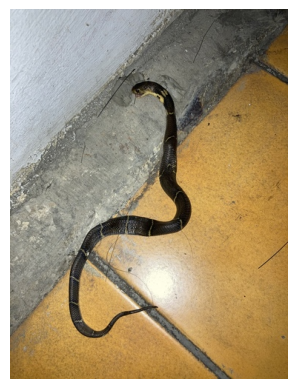

In [ ]:
# Path to the DATA.zip file
zip_file_path = 'DATA1.zip'

# Name of the folder containing images
folder_name = 'Venom_0'

# List to store tuples of (image, filename)
images_with_filenames = []

# Open the ZIP file
with ZipFile(zip_file_path, 'r') as zip_ref:
    # List contents of the sample_0/Venom_0 folder
    folder_contents = zip_ref.namelist()

    # Iterate through the files in the folder
    for file_name in folder_contents:
        # Check if the file is a JPEG image
        if file_name.startswith(f'sample_0/{folder_name}/') and file_name.endswith('.jpg'):
            # Extract the filename without the folder path
            _, filename = os.path.split(file_name)
            # Read the image data from the ZIP file
            with zip_ref.open(file_name) as file:
                # Open the image using PIL
                img = Image.open(io.BytesIO(file.read()))
                # Append the tuple (image, filename) to the list
                images_with_filenames.append((img, filename))

# Select a random tuple containing an image and its filename
random_tuple = random.choice(images_with_filenames)
random_image = random_tuple[0]  # Extract the image from the tuple
file_name = random_tuple[1]     # Extract the filename from the tuple

# Display the random image along with its filename
plt.imshow(random_image)
print(f'Filename: {file_name}')
plt.axis('off')  # Turn off axis labels
plt.show()

# 2.b.display grid of images

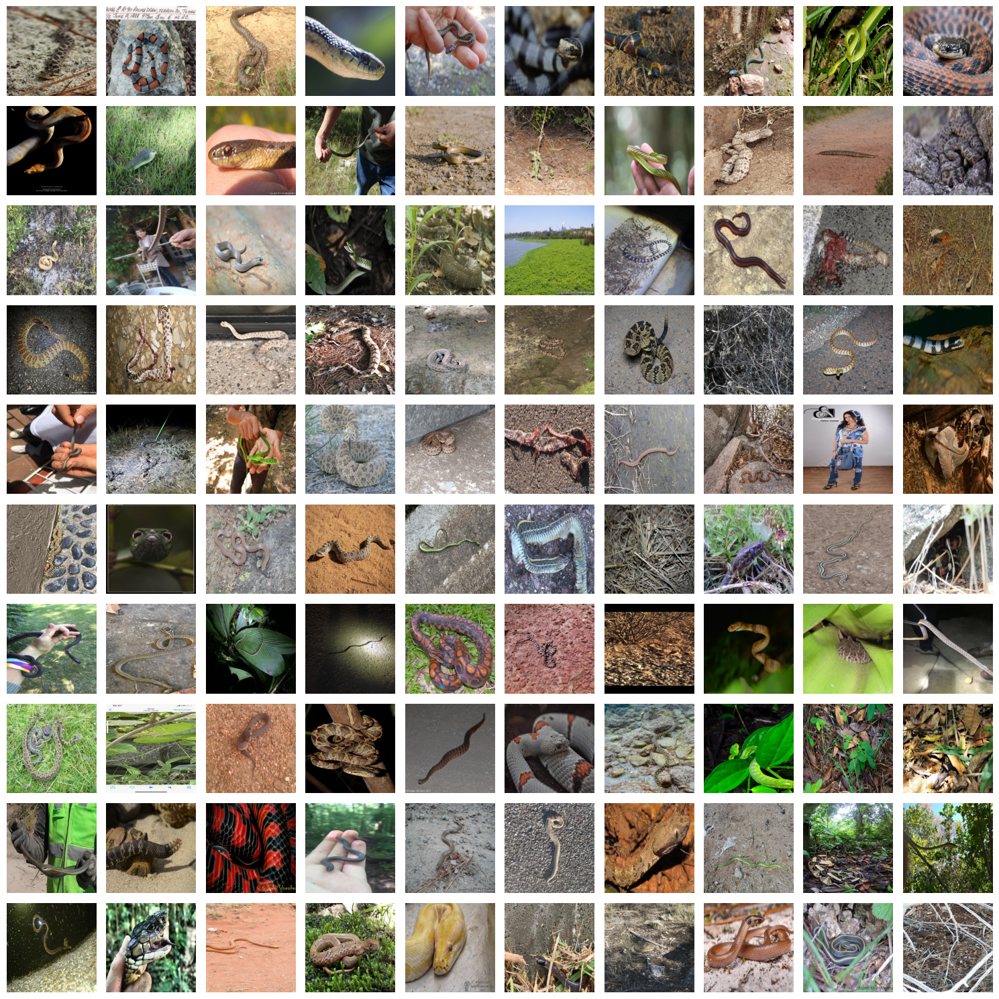

In [ ]:
# Shuffle the list of images_with_filenames
random.shuffle(images_with_filenames)

# Create a 10x10 grid of subplots
fig, axes = plt.subplots(10, 10, figsize=(15, 15))

# Iterate over the images and display them in the subplots
for i in range(100):  # 10x10 grid = 100 subplots
    # Select the image and filename tuple
    img, _ = images_with_filenames[i]

    # Resize the image to (600, 600) using the BOX filter
    img = img.resize((600, 600), Image.BOX)

    # Display the image on the current subplot
    axes[i // 10, i % 10].imshow(img)
    axes[i // 10, i % 10].axis('off')  # Turn off axis labels

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()

An imporant note to make is not all images appear to be of snakes. This will be handled later on.

# 2.c.Statistical data

These data contains 41250  images of snakes


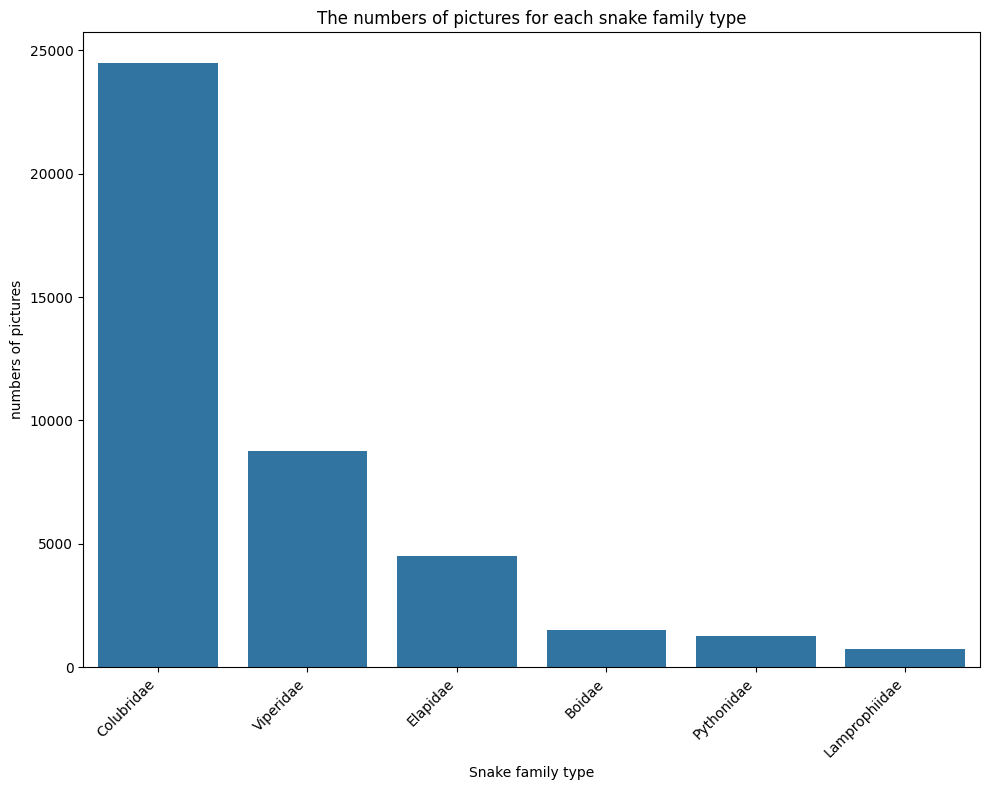

In [ ]:
print('These data contains' + ' ' + str(len(df))+' '+' images of snakes')

# Count the occurrences of each value in the 'family' column
family_counts = df['family'].value_counts()

# Plotting
plt.figure(figsize=(10, 8))
sns.barplot(x=family_counts.index, y=family_counts.values)
plt.title('The numbers of pictures for each snake family type')
plt.xlabel('Snake family type')
plt.ylabel('numbers of pictures')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.tight_layout()
plt.show()


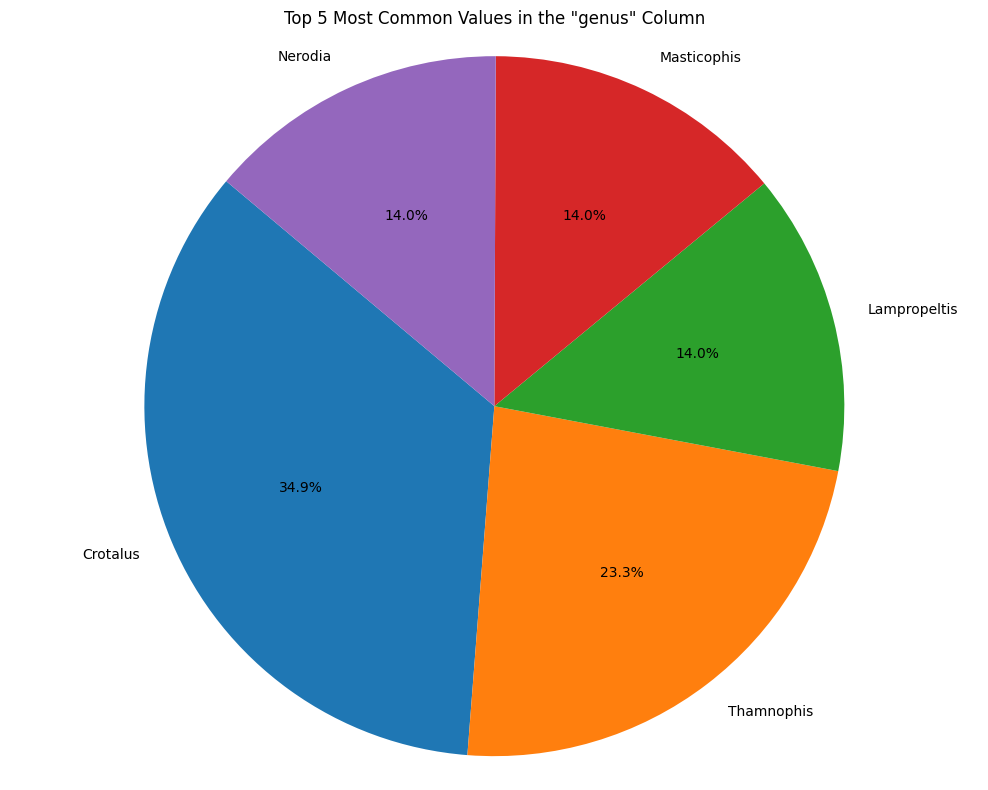

In [ ]:
# Calculate the value counts for the 'genus' column
genus_counts = df['genus'].value_counts().head(5)

# Plotting
plt.figure(figsize=(10, 8))
plt.pie(genus_counts, labels=genus_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Top 5 Most Common Values in the "genus" Column')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.tight_layout()
plt.show()

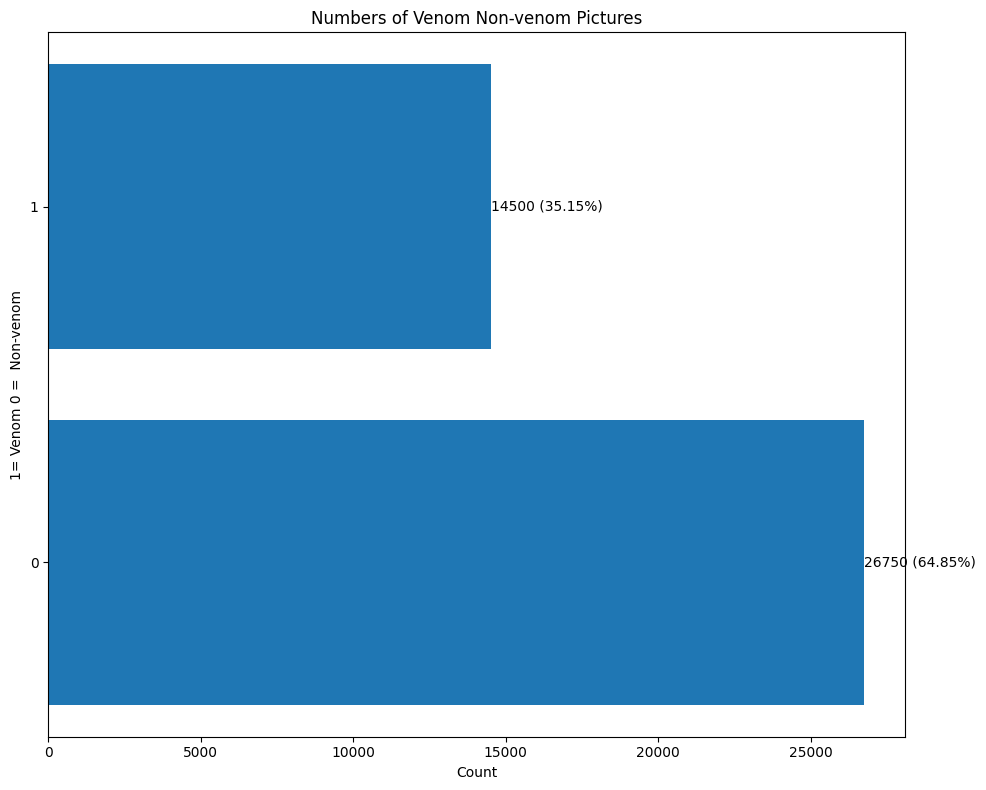

In [ ]:
poisonous_counts = df['poisonous'].value_counts()

# Calculate the total count of rows
total_count = len(df)

# Calculate the percentages
poisonous_percentages = (poisonous_counts / total_count) * 100

# Plotting
plt.figure(figsize=(10, 8))
bars = plt.barh(poisonous_counts.index.astype(str), poisonous_counts.values)
plt.xlabel('Count')
plt.ylabel('1= Venom 0 =  Non-venom')
plt.title('Numbers of Venom Non-venom Pictures')

# Add count and percentage text above each bar
for bar, count, percent in zip(bars, poisonous_counts.values, poisonous_percentages):
    plt.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{count} ({percent:.2f}%)', va='center', fontsize=10)

plt.tight_layout()
plt.show()

It appears data isn't balanced across classifications. This should be handled as well before data is handed to the model.

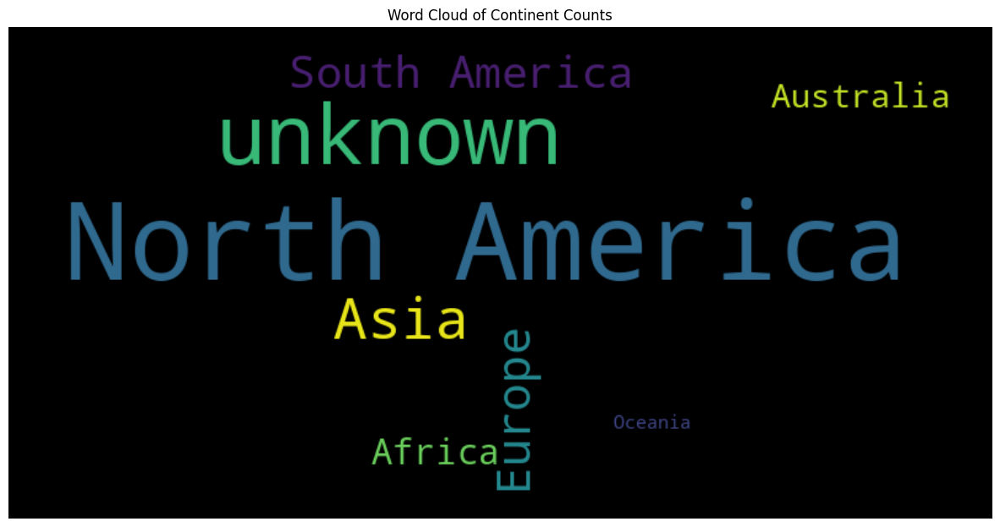

In [ ]:
# Create a word cloud object
wordcloud = WordCloud(width=800, height=400, background_color='black').generate_from_frequencies(df['continent'].value_counts())

# Display the word cloud
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Continent Counts')
plt.show()

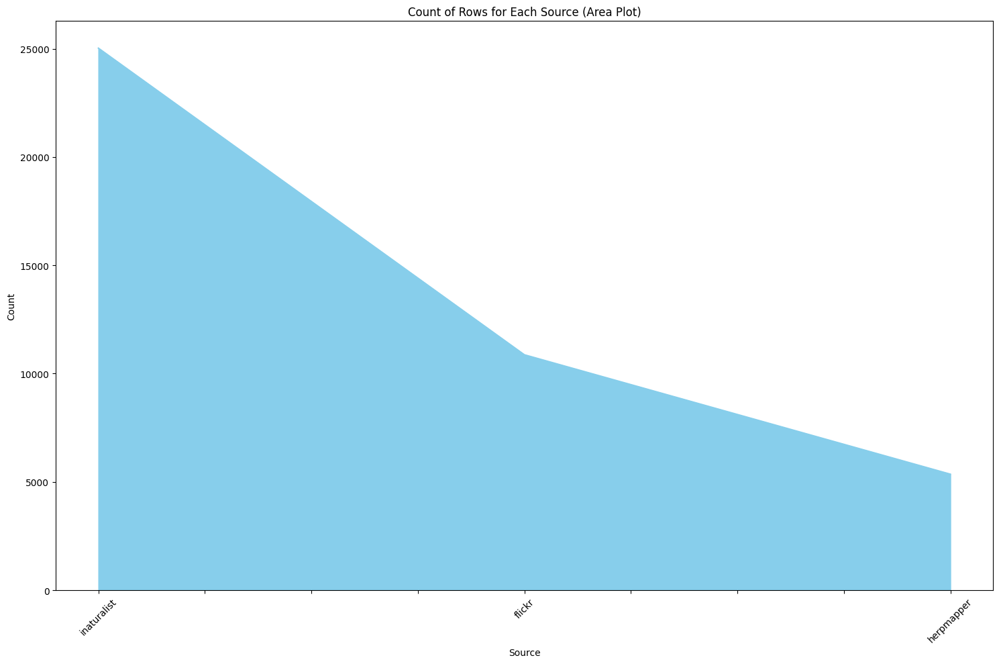

In [ ]:
source_counts = df['source'].value_counts()

# Sort the values by count in descending order
source_counts_sorted = source_counts.sort_values(ascending=False)

# Plot the data as an area plot
plt.figure(figsize=(15, 10))
source_counts_sorted.plot(kind='area', color='skyblue')
plt.xlabel('Source')
plt.ylabel('Count')
plt.title('Count of Rows for Each Source (Area Plot)')
plt.xticks(rotation=45)  # Rotate the x-axis labels for better readability
plt.tight_layout()
plt.show()

In [ ]:
# Group by 'continent'
grouped = df.groupby('continent')

# Aggregate data to get total counts, unique counts, and venomous counts of unique species
continent_summary = grouped.agg(
    total_snakes=('binomial', 'size'),  # Count of all snake entries per continent
    unique_snakes=('binomial', pd.Series.nunique),  # Count of unique snake species per continent
).join(
    # This part counts how many of the unique snakes are venomous
    grouped.apply(lambda x: x[x['poisonous'] == 1]['binomial'].nunique()).rename('unique_venomous_snakes')
)

# Calculate the sum of each column and create a new DataFrame for the total row
total_row = pd.DataFrame([continent_summary.sum()], index=['Total'])

# Concatenate the original DataFrame with the new 'total_row' DataFrame
continent_summary = pd.concat([continent_summary, total_row])

# Print the resulting DataFrame with the total row
print(continent_summary)

               total_snakes  unique_snakes  unique_venomous_snakes
Africa                 1455             19                      10
Asia                   3835             38                      18
Australia              1217             19                      11
Europe                 2519             50                      22
North America         19455            113                      29
Oceania                 127             12                       9
South America          2318             56                      13
unknown               10324            165                      58
Total                 41250            472                     170


In [ ]:
# Styling
def highlight_max(s, props=''):
    return np.where(s == np.nanmax(s.to_numpy()), props, '')

styled_table = continent_summary.style.apply(highlight_max, props='color:white;background-color:darkblue;', axis=0)\
    .background_gradient(cmap='Blues', subset=['total_snakes', 'unique_snakes'])\
    .background_gradient(cmap='Greens', subset=['unique_venomous_snakes'])\
    .bar(subset=['total_snakes', 'unique_snakes', 'unique_venomous_snakes'], color='#FFA07A')\
    .format("{:.0f}")\
    .set_caption("Summary of Snakes by Continent")\
    .set_table_styles([{
        'selector': 'caption',
        'props': [('color', 'black'), ('font-size', '16px')]
    }])\
    .set_properties(**{'text-align': 'center', 'font-size': '14px'})

# Display the styled DataFrame in a Jupyter Notebook
styled_table

,total_snakes,unique_snakes,unique_venomous_snakes
Africa,1455,19,10
Asia,3835,38,18
Australia,1217,19,11
Europe,2519,50,22
North America,19455,113,29
Oceania,127,12,9
South America,2318,56,13
unknown,10324,165,58
Total,41250,472,170


# Step 3: Pre-processing the Data

# 3.a Cleaning the Data

After looking at the grid of the images, we observed some images are completely unrelated to snakes.
It appears the source of them is from Flicker.
We decided to remove them altogether.

In [ ]:
df['source'].unique()

array(['inaturalist', 'flickr', 'herpmapper'], dtype=object)

In [ ]:
df = df[df['source'] != 'flickr']

In [ ]:
df['source'].unique()

array(['inaturalist', 'herpmapper'], dtype=object)

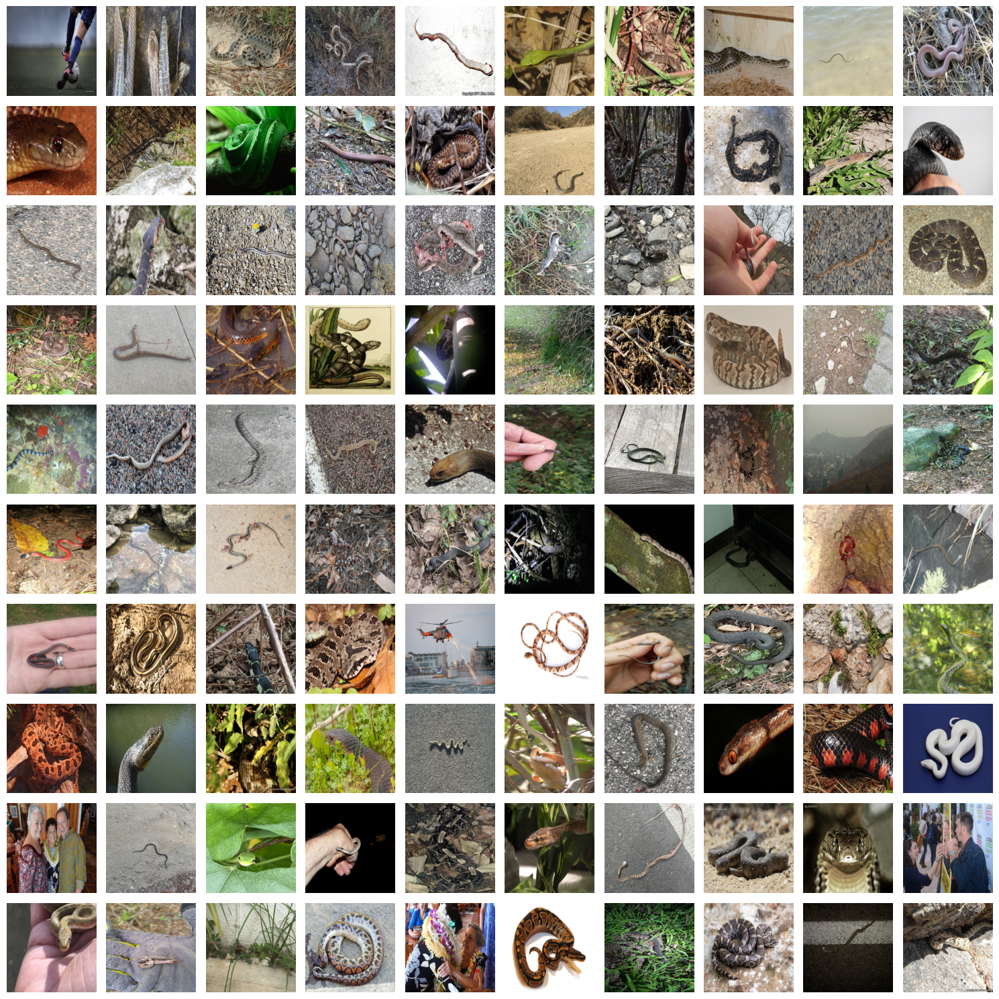

In [ ]:
# Shuffle the list of images_with_filenames
random.shuffle(images_with_filenames)

# Create a 10x10 grid of subplots
fig, axes = plt.subplots(10, 10, figsize=(15, 15))

# Iterate over the images and display them in the subplots
for i in range(100):  # 10x10 grid = 100 subplots
    # Select the image and filename tuple
    img, _ = images_with_filenames[i]

    # Resize the image to (600, 600) using the BOX filter
    img = img.resize((600, 600), Image.BOX)

    # Display the image on the current subplot
    axes[i // 10, i % 10].imshow(img)
    axes[i // 10, i % 10].axis('off')  # Turn off axis labels

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()

It appears many junk images are still left. Due to time constrainst we couldn't handle this further, and we do understand the massive effects this can have on our model and results.

Now let's fix the imbalance between the classifications. We want to have approximately equal representations for each classification in the data, so that when we train the model, it won't be biased towars one classification. We will randomally erase non-venom images from the dataframe so that amounts are equal.

In [ ]:
# Separate rows with value 1 and 0 in the 'poisonous' column
df_ones = df[df['poisonous'] == 1]
df_zeros = df[df['poisonous'] == 0]

# Find the minimum count of rows with value 1 or 0
min_count = min(len(df_ones), len(df_zeros))

# Randomly sample equal number of rows from each group
df_ones_sampled = df_ones.sample(n=min_count, random_state=42)
df_zeros_sampled = df_zeros.sample(n=min_count, random_state=42)

# Concatenate the sampled DataFrames
df_new = pd.concat([df_ones_sampled, df_zeros_sampled], ignore_index=True)

# Shuffle the rows of the new DataFrame
df = df_new.sample(frac=1, random_state=42).reset_index(drop=True)

# Print the updated DataFrame
print(df['poisonous'].value_counts())

poisonous
0    9609
1    9609
Name: count, dtype: int64


Now df_new contains an equal number of rows with value 1 and 0 from the original DataFrame df

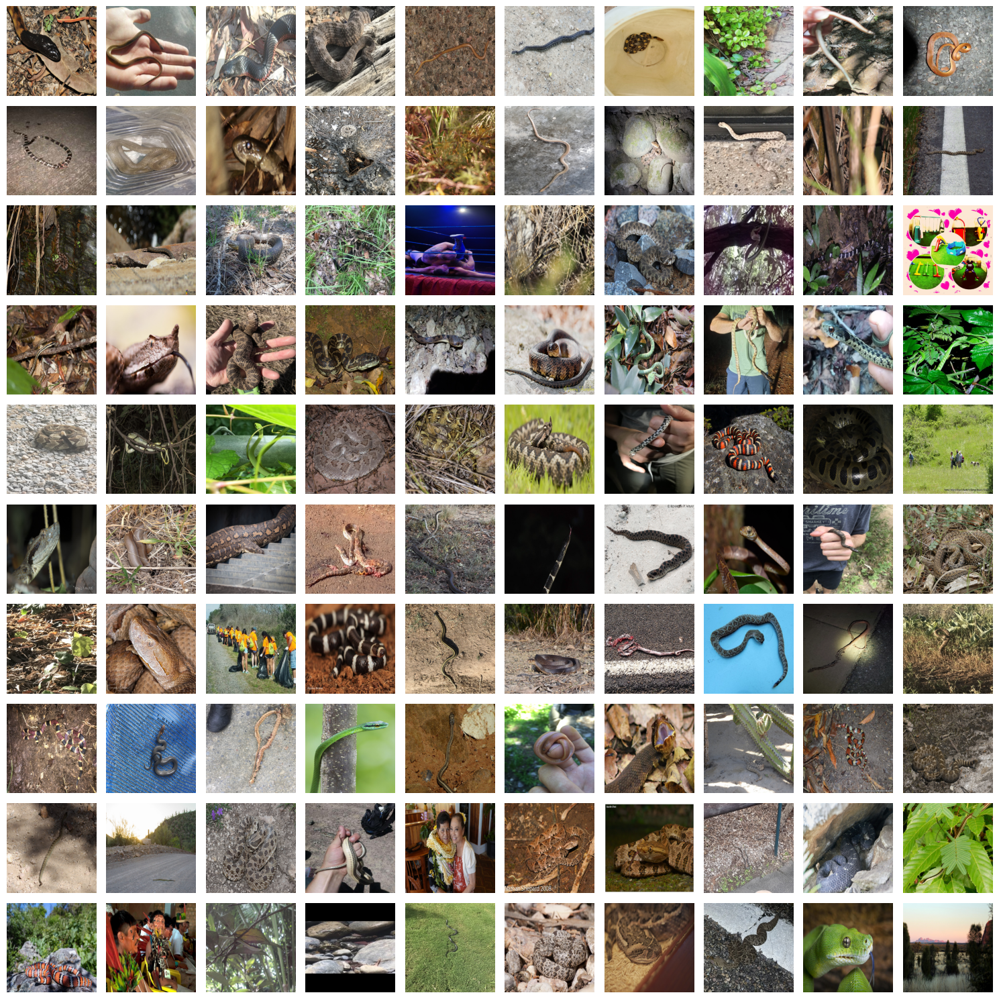

In [ ]:
# Shuffle the list of images_with_filenames
random.shuffle(images_with_filenames)

# Create a 10x10 grid of subplots
fig, axes = plt.subplots(10, 10, figsize=(15, 15))

# Iterate over the images and display them in the subplots
for i in range(100):  # 10x10 grid = 100 subplots
    # Select the image and filename tuple
    img, _ = images_with_filenames[i]

    # Resize the image to (600, 600) using the BOX filter
    img = img.resize((600, 600), Image.BOX)

    # Display the image on the current subplot
    axes[i // 10, i % 10].imshow(img)
    axes[i // 10, i % 10].axis('off')  # Turn off axis labels

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()

# 3.b.Preprocessing Images into Pixel Vectors

The cell below defines the function responsible for loading and resizing images from the ZIP file. It handles cases where images are found in different folders within the ZIP file. The function ensures that images are resized to a specified target size and converted to numpy arrays for further processing.

An important note is, although images were separated into venom / non-venom folders, both folders hold both venomous and non-venomous snakes. This is handled below.

In [ ]:
# Cell 4: Function to load and resize image
width = 240
def load_and_resize_image(zip_ref, file_name, target_size=(width, width)):
    found_in_folders = False
    try:
        venom_file_path = f'sample_0/Venom_0/{file_name}'
        with zip_ref.open(venom_file_path) as file:
            img = Image.open(file)
            img = img.resize(target_size)
            img_array = np.array(img)
            if img_array.shape != (width, width, 3):
                raise ValueError("Image shape does not match the target size")
            found_in_folders = True
            return img_array, found_in_folders
    except Exception as e:
        try:
            non_venom_file_path = f'sample_0/Non-venom_0/{file_name}'
            with zip_ref.open(non_venom_file_path) as file:
                img = Image.open(file)
                img = img.resize(target_size)
                img_array = np.array(img)
                if img_array.shape != (width, width, 3):
                    raise ValueError("Image shape does not match the target size")
                found_in_folders = True
                return img_array, found_in_folders
        except Exception as e:
            print(f"Image '{file_name}' not found in the ZIP file or does not match the target size.")
            return None, found_in_folders

# Step 4: Find the best model

The cell below contains a function that handles the model. It checks if a pre-trained model exists and loads it if available. If a pre-trained model is not found, it defines and compiles a new model architecture using Keras, consisting of convolutional and dense layers for image classification tasks.

The model was iterated multiple times, separately fine-tuning parameters and playing with layers and number of neurons, until reaching the best result we've reached so far. Due to time constraints, we are satisfied with the results for this course purposes.

* The Flatten layer is placed after the last convolutional layer to transition from convolutional layers to fully connected layers.
* We're using the Adam optimizer with a binary crossentropy loss function, which is suitable for binary classification tasks.
* BatchNormalization layers are added after each convolutional layer to stabilize the learning process.
* MaxPooling layers are added after each convolutional layer except the last one to reduce the spatial dimensions of the feature maps.

In [ ]:
def init_model():
    if os.path.exists('model.h5'):
        # Load the model from a file
        model = load_model('model.h5')
        print("Using a pre-saved model...")
    else:
        print("Looking for the best model...")
        # Define and compile the model
        model = Sequential([Rescaling(1./255),
                            RandomFlip("horizontal_and_vertical"),
                            RandomRotation(0.2),
                            RandomContrast(0.2),
                            RandomZoom(height_factor=(0.2, 0.3))])

        # Convolutional layers
        width = 240
        model.add(Conv2D(32, (3, 3), input_shape=(width, width, 3)))
        model.add(BatchNormalization())
        model.add(ReLU())
        model.add(MaxPooling2D((2, 2)))

        model.add(Conv2D(64, (3, 3)))
        model.add(BatchNormalization())
        model.add(ReLU())
        model.add(MaxPooling2D((2, 2)))

        model.add(Conv2D(128, (3, 3)))
        model.add(BatchNormalization())
        model.add(ReLU())
        model.add(MaxPooling2D((2, 2)))

        model.add(Conv2D(256, (3, 3)))
        model.add(BatchNormalization())
        model.add(ReLU())
        model.add(MaxPooling2D((2, 2)))

        model.add(Conv2D(512, (3, 3)))
        model.add(BatchNormalization())
        model.add(ReLU())
        model.add(MaxPooling2D((2, 2)))

        # Flatten layer
        model.add(Flatten())

        # Dense layers
        model.add(Dense(1024))
        model.add(BatchNormalization())
        model.add(ReLU())

        model.add(Dense(512))
        model.add(BatchNormalization())
        model.add(ReLU())

        model.add(Dense(256))
        model.add(BatchNormalization())

        # Output layer
        model.add(Dense(1, activation='sigmoid'))

        model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
        model.build(input_shape=(None, width, width, 3))
        print(model.summary())

        model.save('model.h5')
    return model

Here, the script checks if preprocessed image data and labels are available. If not, it loads images from the ZIP file, preprocesses them (including resizing and normalization), and saves the data to disk in numpy array format. If the preprocessed data exists, it is loaded into memory.

10K images were randomly chosen and loaded out of approximately 18K images. 8K images were left for testing purposes.

In [ ]:
# Cell 6: Loading and preprocessing image data
if not os.path.exists('image_data.npy') or not os.path.exists('labels_data.npy'):
    with ZipFile(zip_file_path, 'r') as zip_ref:
        num_images = min(len(df), 10000)
        sample_df = df.sample(n=num_images, random_state=42)
        image_data = []
        labels_data = []
        processed_count = 0
        with open('uuid_images.txt', 'w') as file:
            for index, row in sample_df.iterrows():
                processed_count += 1
                print(f"Processing image {processed_count}/{num_images}: {row['uuid_image']}")
                file.write(row['uuid_image'] + '\n')
                img_array, found = load_and_resize_image(zip_ref, row['uuid_image'])
                if found:
                    image_data.append(img_array)
                    labels_data.append(row['poisonous'])
    image_data = np.array(image_data)
    labels_data = np.array(labels_data)
    np.save('image_data.npy', image_data)
    np.save('labels_data.npy', labels_data)
else:
    image_data = np.load('image_data.npy')
    labels_data = np.load('labels_data.npy')

Streaming output truncated to the last 5000 lines.
Processing image 5018/10000: 2f7e71a3a26a4e689ea8df8c7e5a129c.jpg
Processing image 5019/10000: 39b9580fac954aba85adcb20c6f2d7da.jpg
Processing image 5020/10000: ad06210bbaba405c8ee47befb779f447.jpg
Processing image 5021/10000: f8f9348d45394e66b8f1dee8f5e62790.jpg
Processing image 5022/10000: cac331626fd34f32953478409f363564.jpg
Processing image 5023/10000: cc43fbc482994fc0b9273e443dbfd4f9.jpg
Processing image 5024/10000: 8fed92203ef84ed89ccbc415233fad78.jpg
Processing image 5025/10000: 9512464a8c85472c852d15c4783b45ee.jpg
Processing image 5026/10000: 99662953e4f44b5e9ad8d657b4e627c3.jpg
Processing image 5027/10000: aad8d55289e0468fbf5678f9690f3b69.jpg
Processing image 5028/10000: ba1d6b3ca32a4301b765ccbabf102b72.jpg
Processing image 5029/10000: d4f93887109b48d6a996a97cbac2cca0.jpg
Processing image 5030/10000: 0852df98426b4c0796f0115cfd49755f.jpg
Processing image 5031/10000: bc5cfa0da2084c9eaf927e1d68787cec.jpg
Processing image 5032/100

The cell below splits the loaded image data into training and validation sets using an 80-20 split ratio. The training set is used to train the model, while the validation set is used to evaluate the model's performance during training and prevent overfitting or underfitting.

In [ ]:
# Cell 7: Performing train/validation split
train_images, val_images, train_labels, val_labels = train_test_split(image_data, labels_data, test_size=0.2,
                                                                      random_state=42)
print("Train images shape:", train_images.shape)
print("Val images shape:", val_images.shape)
print("Train labels shape:", train_labels.shape)
print("Val labels shape:", val_labels.shape)
train_labels = train_labels.flatten()
val_labels = val_labels.flatten()


Train images shape: (7976, 240, 240, 3)
Val images shape: (1994, 240, 240, 3)
Train labels shape: (7976,)
Val labels shape: (1994,)


In [ ]:
# Cell 8: Model training
model = init_model()
start_time = time.time()
history = model.fit(train_images, train_labels, validation_data=(val_images, val_labels), epochs=10,
                    batch_size=32, verbose=2)
end_time = time.time()
training_time = end_time - start_time

Using a pre-saved model...
Epoch 1/10
250/250 - 29s - loss: 0.7249 - accuracy: 0.5400 - val_loss: 0.8074 - val_accuracy: 0.5150 - 29s/epoch - 117ms/step
Epoch 2/10
250/250 - 24s - loss: 0.6835 - accuracy: 0.5549 - val_loss: 1.0845 - val_accuracy: 0.5321 - 24s/epoch - 97ms/step
Epoch 3/10
250/250 - 25s - loss: 0.6749 - accuracy: 0.5686 - val_loss: 0.7491 - val_accuracy: 0.5226 - 25s/epoch - 98ms/step
Epoch 4/10
250/250 - 25s - loss: 0.6694 - accuracy: 0.5762 - val_loss: 0.8566 - val_accuracy: 0.5115 - 25s/epoch - 98ms/step
Epoch 5/10
250/250 - 25s - loss: 0.6707 - accuracy: 0.5759 - val_loss: 0.7270 - val_accuracy: 0.4814 - 25s/epoch - 99ms/step
Epoch 6/10
250/250 - 25s - loss: 0.6720 - accuracy: 0.5685 - val_loss: 0.6780 - val_accuracy: 0.5582 - 25s/epoch - 99ms/step
Epoch 7/10
250/250 - 25s - loss: 0.6627 - accuracy: 0.5781 - val_loss: 0.6912 - val_accuracy: 0.5411 - 25s/epoch - 100ms/step
Epoch 8/10
250/250 - 25s - loss: 0.6643 - accuracy: 0.5751 - val_loss: 1.4074 - val_accuracy: 0.

In [ ]:
model.summary()

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling_6 (Rescaling)     (None, 240, 240, 3)       0         
                                                                 
 random_flip_6 (RandomFlip)  (None, 240, 240, 3)       0         
                                                                 
 random_rotation_6 (RandomR  (None, 240, 240, 3)       0         
 otation)                                                        
                                                                 
 random_contrast_6 (RandomC  (None, 240, 240, 3)       0         
 ontrast)                                                        
                                                                 
 random_zoom_6 (RandomZoom)  (None, 240, 240, 3)       0         
                                                                 
 conv2d_30 (Conv2D)          (None, 238, 238, 32)    

In [ ]:
# Cell 9: Evaluating the model
_, test_accuracy = model.evaluate(val_images, val_labels)
print("Test Accuracy:", test_accuracy)
print("Training Time:", training_time)

63/63 [==============================] - 2s 27ms/step - loss: 0.6771 - accuracy: 0.5597
Test Accuracy: 0.5596790313720703
Training Time: 261.76941871643066


After training the model, inference is performed on a set of 20 unseen images to predict their labels. This process simulates real-world scenarios where the model needs to classify images it has not seen during training. Each image is loaded, resized, and passed through the trained model for prediction. The predicted probability of the snake in each image being venomous is calculated, along with the actual label obtained from the dataset. This allows for a comparison between the model's predictions and ground truth labels. Furthermore, the chosen images, along with their predicted labels, are visually displayed for qualitative assessment of the model's performance.

# Step 5: testing the model by predication

Filename: 10d059e4b14f42faa230a1666a004d14.jpg
Image at index 1649 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 20ms/step
Predicted probabilty of the snake in picture being venomous: 0.7123411893844604
Predicted label: Venom
Actual label: Venom
True Prediction


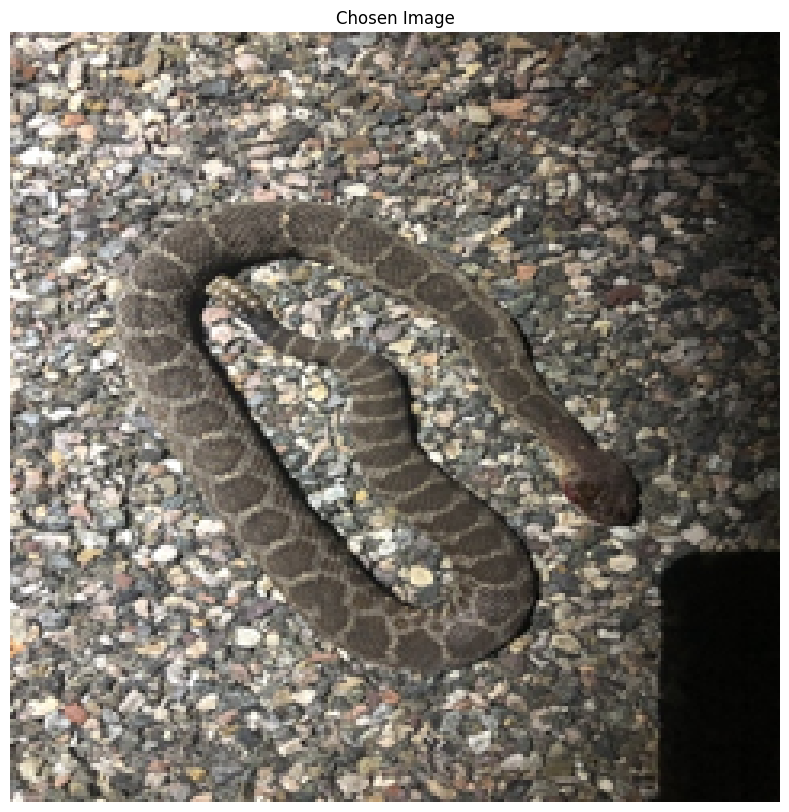

Filename: 158f45134e714ae19c537ebd2d407bc3.jpg
Image at index 12242 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 20ms/step
Predicted probabilty of the snake in picture being venomous: 0.9012265801429749
Predicted label: Venom
Actual label: Venom
True Prediction


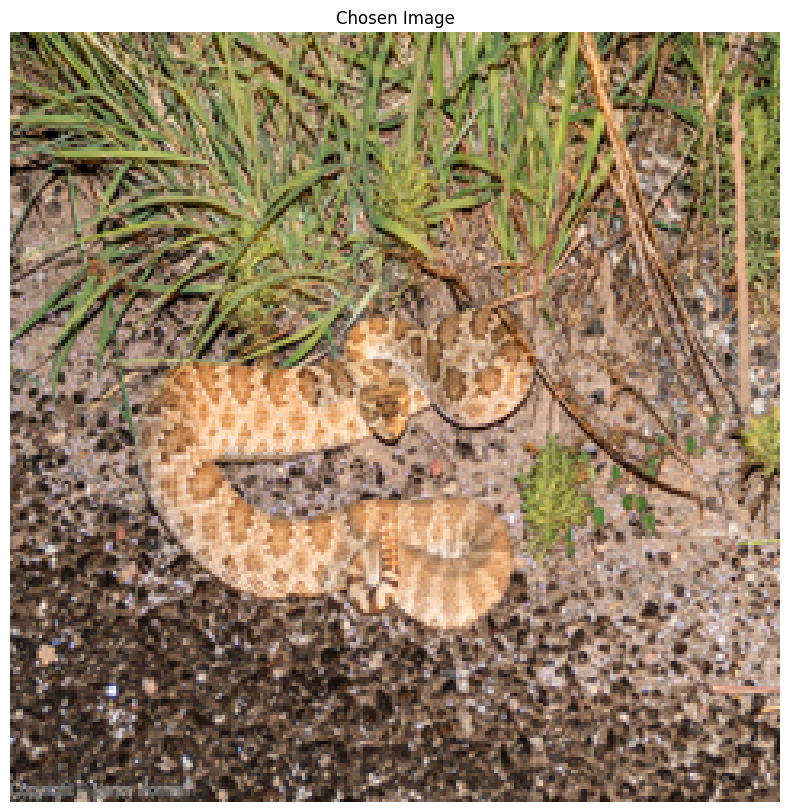

Filename: 95de470a9b1a49babe8a137cbe216006.jpg
Image at index 3323 is listed in the UUIDs text file and can't be used for inference.
Filename: 73ca61df18884f8e96455f56386e4a05.jpg
Image at index 17345 is listed in the UUIDs text file and can't be used for inference.
Filename: b7b811d8a6544c958ad2940b46f57ff4.jpg
Image at index 3472 is listed in the UUIDs text file and can't be used for inference.
Filename: 15cda39c5bdf482f99fdbb872ad3582b.jpg
Image at index 11931 is listed in the UUIDs text file and can't be used for inference.
Filename: 13aede67553c47f1be65acc113a7f541.jpg
Image at index 14305 is listed in the UUIDs text file and can't be used for inference.
Filename: abc78e5af95545d7a61ca0221711e4bb.jpg
Image at index 18320 is listed in the UUIDs text file and can't be used for inference.
Filename: 1e70c969722746c58810f54bcd10ffbf.jpg
Image at index 12956 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 19ms/step
Predicted probabilty of t

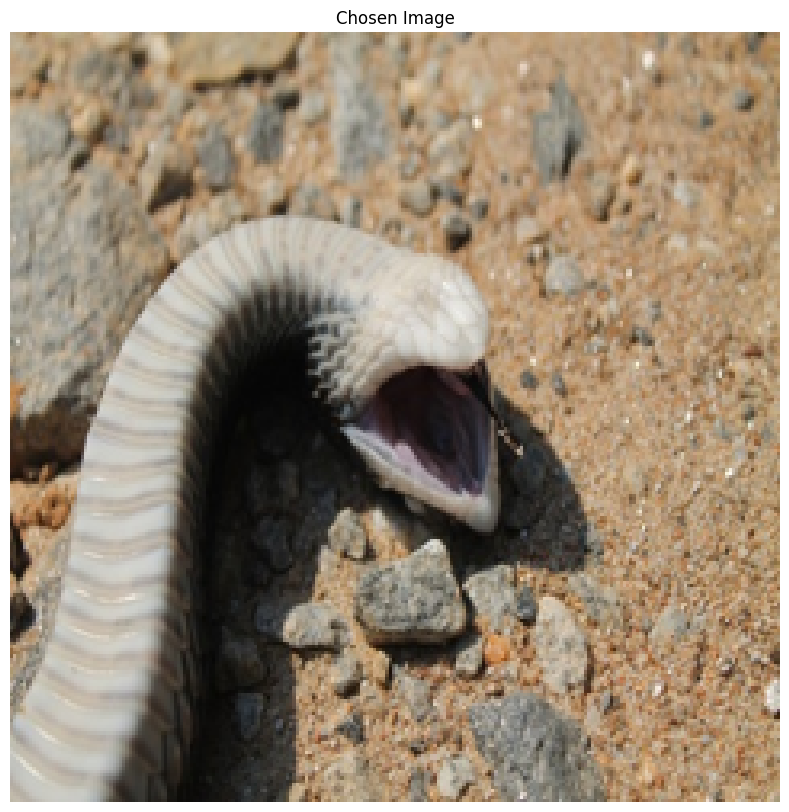

Filename: 442d31480681497bbdf8c1acfe29a1bc.jpg
Image at index 8169 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 20ms/step
Predicted probabilty of the snake in picture being venomous: 0.6384028196334839
Predicted label: Venom
Actual label: Non-Venom
False Prediction


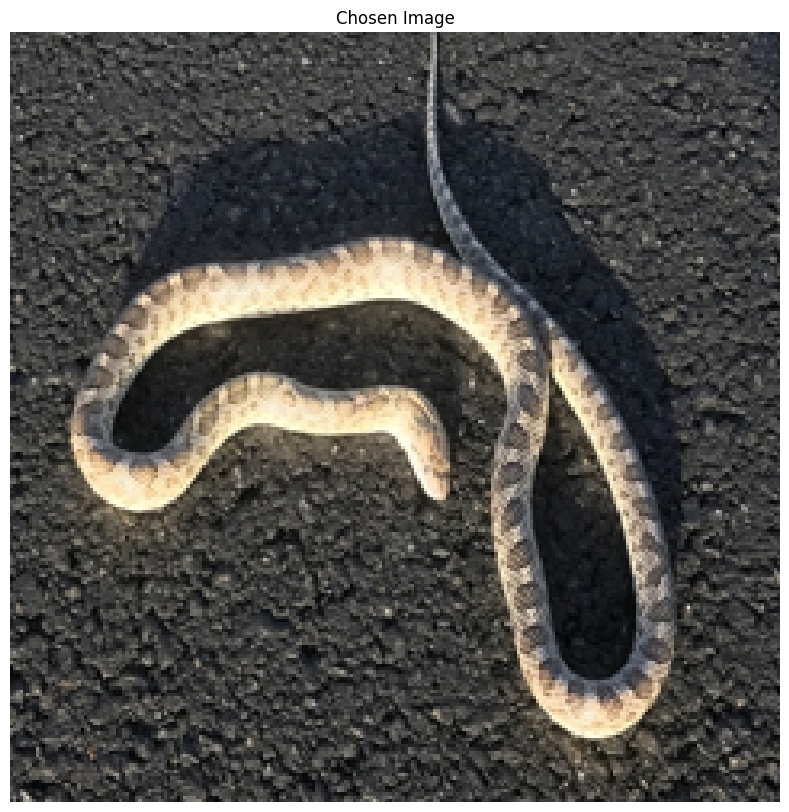

Filename: 19f25ba7d2b349f1a912f97ecb76783e.jpg
Image at index 1465 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 20ms/step
Predicted probabilty of the snake in picture being venomous: 0.5831282734870911
Predicted label: Venom
Actual label: Non-Venom
False Prediction


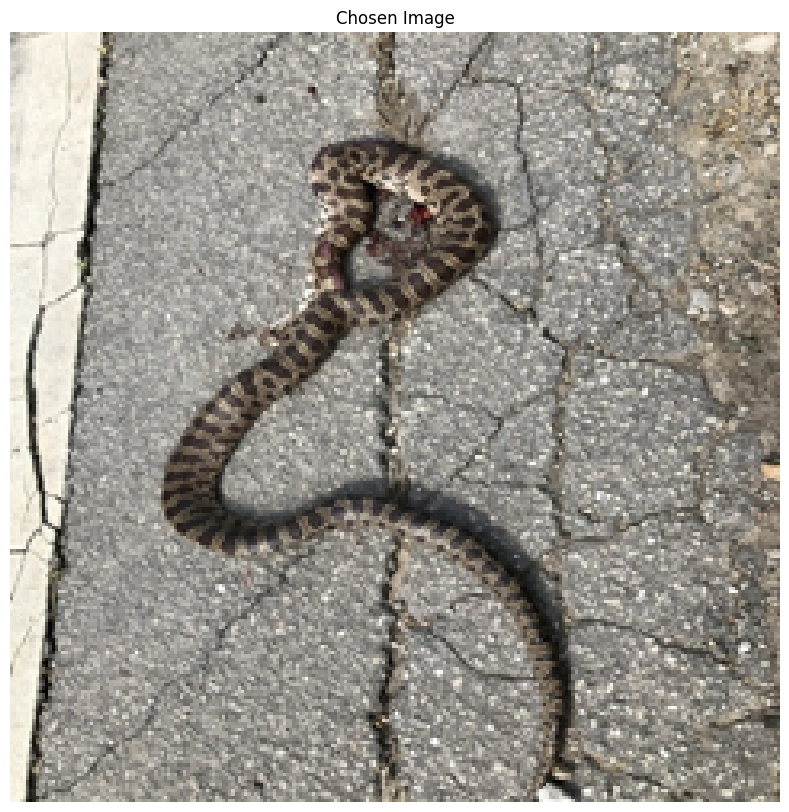

Filename: df8d0a3379074db09b4983ac54c372e6.jpg
Image at index 15840 is listed in the UUIDs text file and can't be used for inference.
Filename: c442a33f03ce4359a2ee3704af9636eb.jpg
Image at index 12772 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 19ms/step
Predicted probabilty of the snake in picture being venomous: 0.7924509048461914
Predicted label: Venom
Actual label: Venom
True Prediction


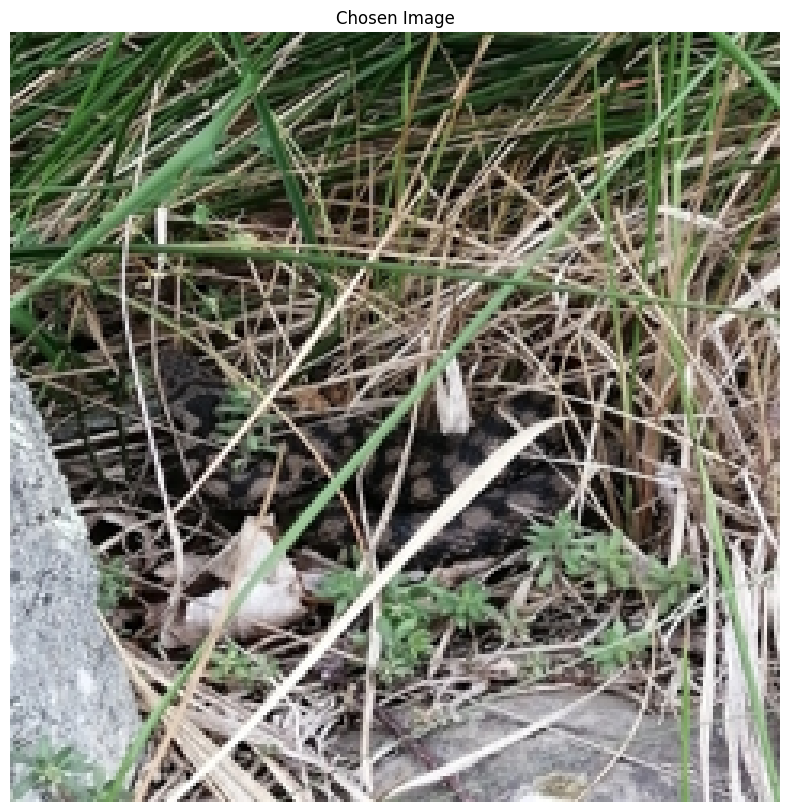

Filename: f86ebf0da13846d58200fcc37d603d55.jpg
Image at index 15942 is listed in the UUIDs text file and can't be used for inference.
Filename: 283cb40834af44afb6a663981b40e338.jpg
Image at index 17700 is listed in the UUIDs text file and can't be used for inference.
Filename: 63afcee5392444a09acc6e039ceff500.jpg
Image at index 18 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 19ms/step
Predicted probabilty of the snake in picture being venomous: 0.6480274796485901
Predicted label: Venom
Actual label: Venom
True Prediction


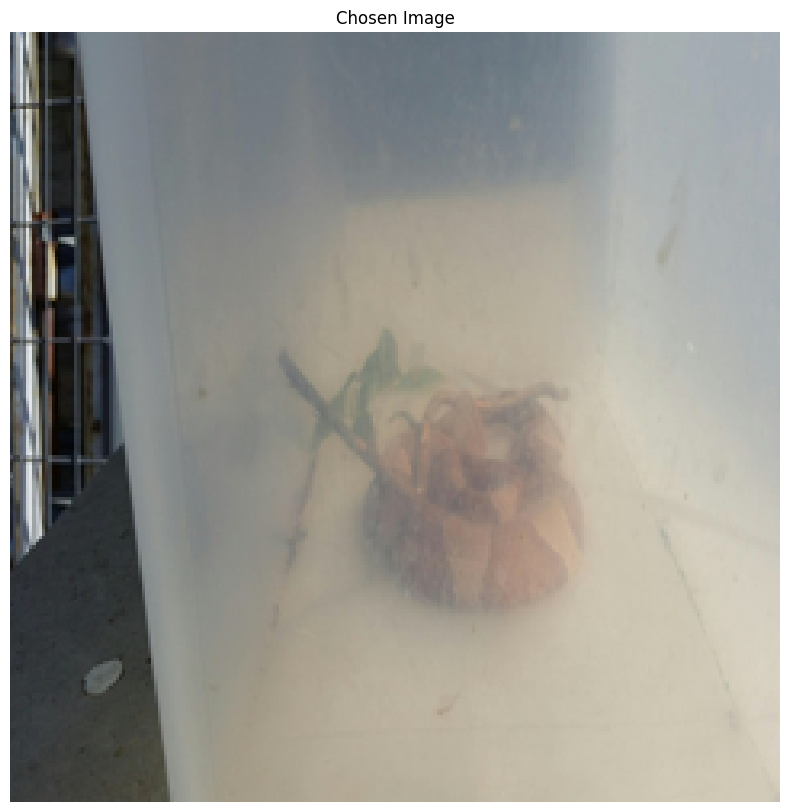

Filename: 900d81a665074d0aa150761e9d65b741.jpg
Image at index 118 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 20ms/step
Predicted probabilty of the snake in picture being venomous: 0.6806817650794983
Predicted label: Venom
Actual label: Venom
True Prediction


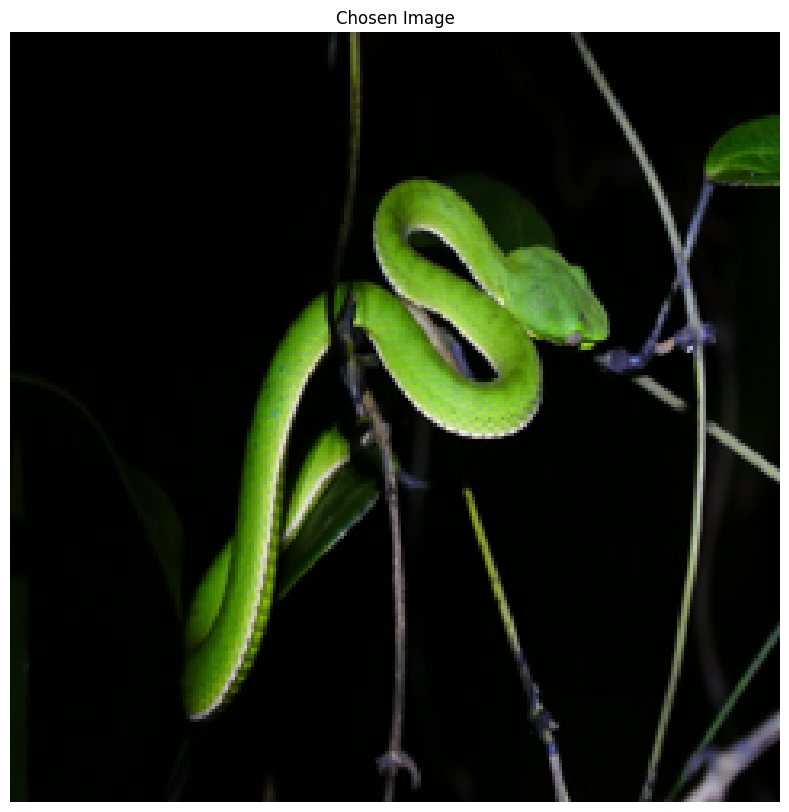

Filename: cd2c4004b5ef4f2593e0b62d4090dd86.jpg
Image at index 16760 is listed in the UUIDs text file and can't be used for inference.
Filename: ee0b3597b7364c51852ae11d3bb05616.jpg
Image at index 9112 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 19ms/step
Predicted probabilty of the snake in picture being venomous: 0.7556830048561096
Predicted label: Venom
Actual label: Non-Venom
False Prediction


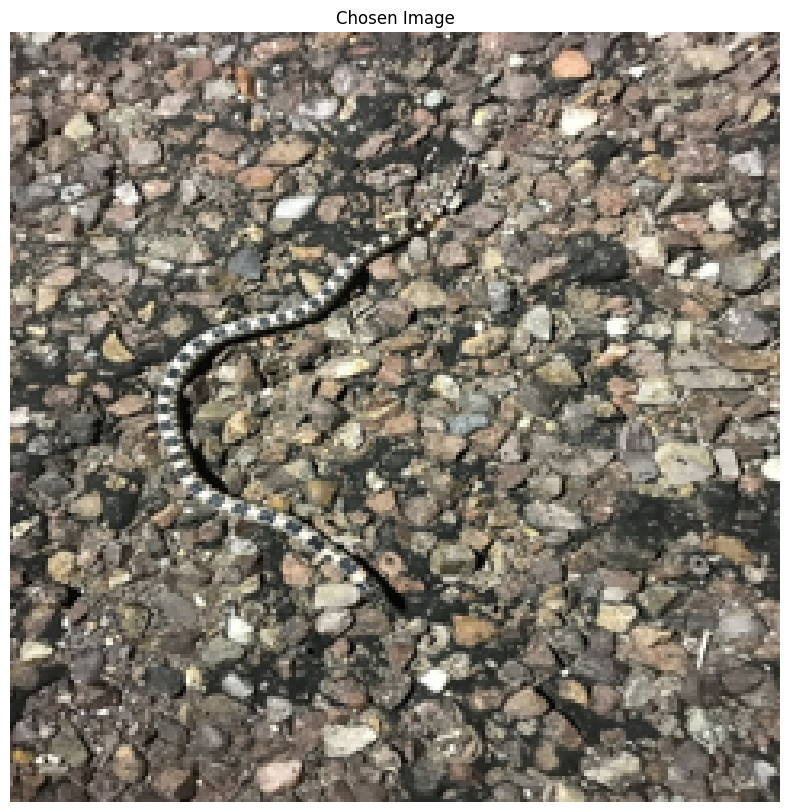

Filename: c6b2c4b801c04bb8ba430dd30b671308.jpg
Image at index 1993 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 20ms/step
Predicted probabilty of the snake in picture being venomous: 0.49716538190841675
Predicted label: Non-Venom
Actual label: Non-Venom
True Prediction


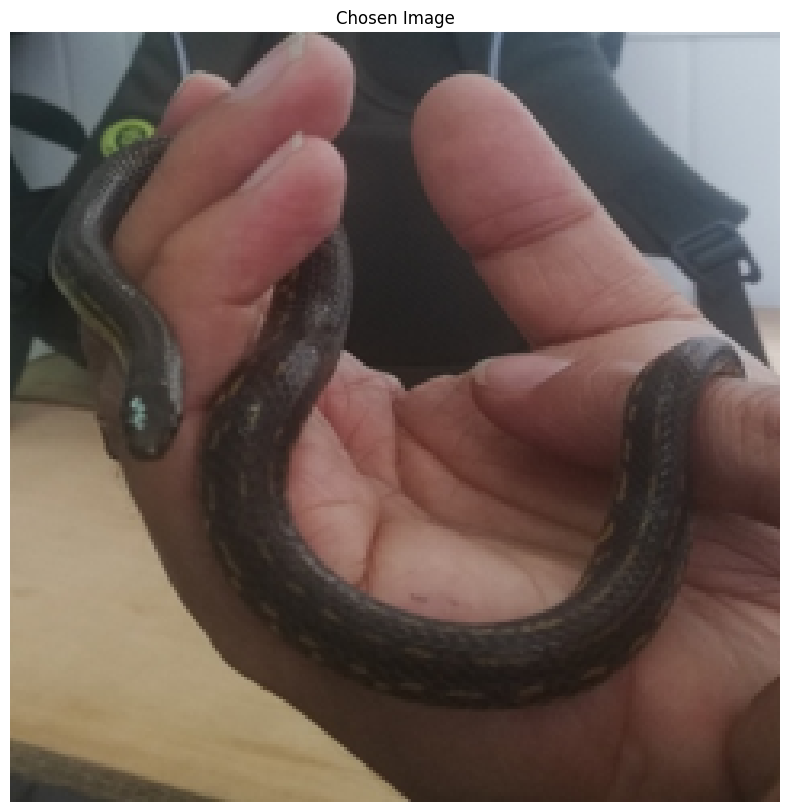

Filename: 9ec8bcf313f84bbfb44b80df10ab0292.jpg
Image at index 11990 is listed in the UUIDs text file and can't be used for inference.
Filename: 4712b0f96dd641e694df136de9ec2290.jpg
Image at index 5989 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 19ms/step
Predicted probabilty of the snake in picture being venomous: 0.24405154585838318
Predicted label: Non-Venom
Actual label: Non-Venom
True Prediction


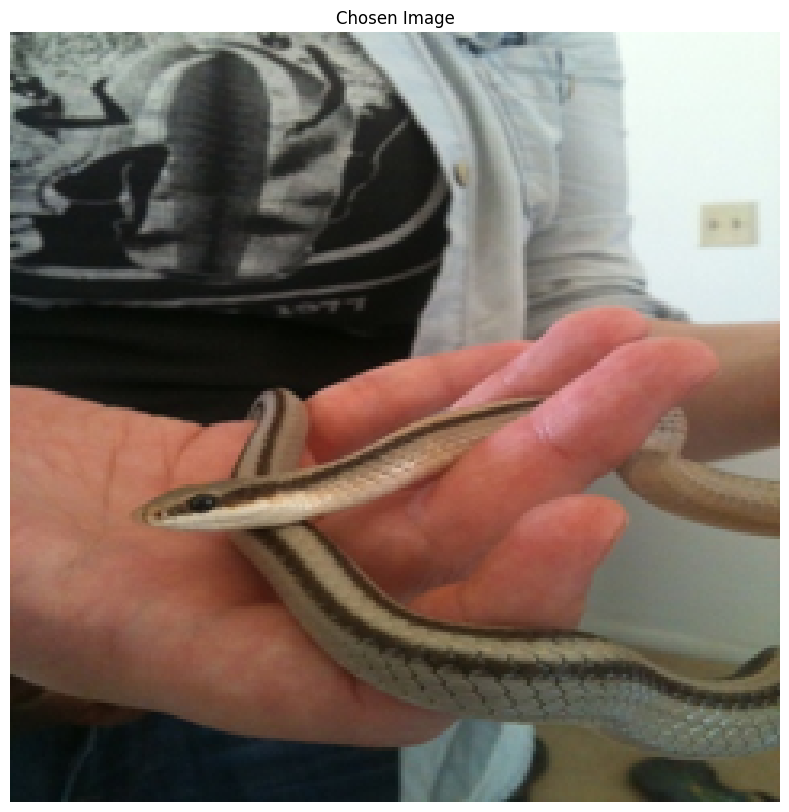

Filename: 36d1c0ba6dc1497589cbcb4a099548cd.jpg
Image at index 9980 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 19ms/step
Predicted probabilty of the snake in picture being venomous: 0.6047095656394958
Predicted label: Venom
Actual label: Venom
True Prediction


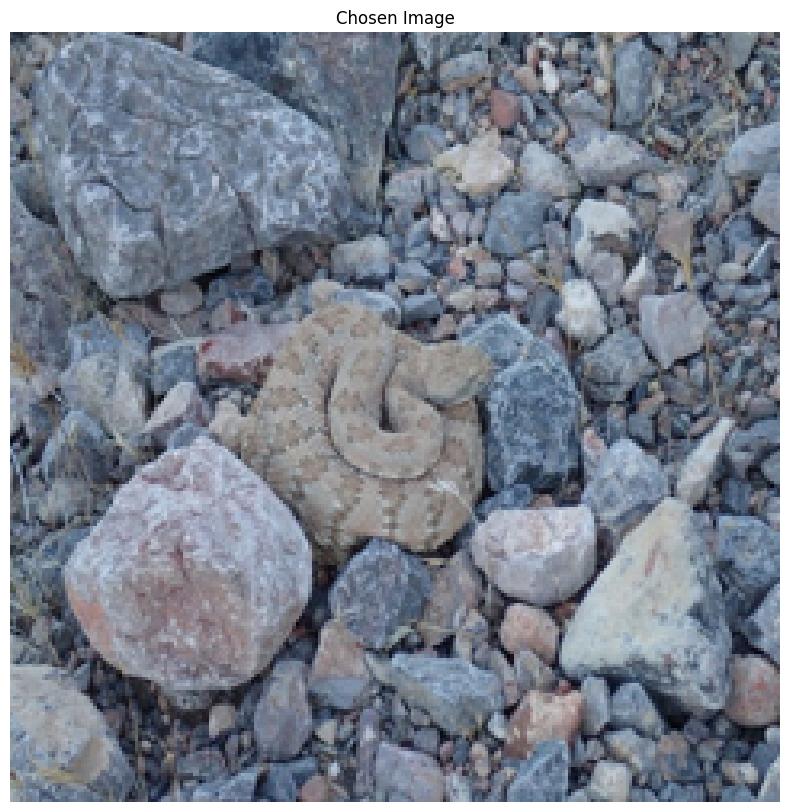

Filename: f714c23c4a2243d38d1fd46aa33014eb.jpg
Image at index 18699 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 23ms/step
Predicted probabilty of the snake in picture being venomous: 0.6525298357009888
Predicted label: Venom
Actual label: Venom
True Prediction


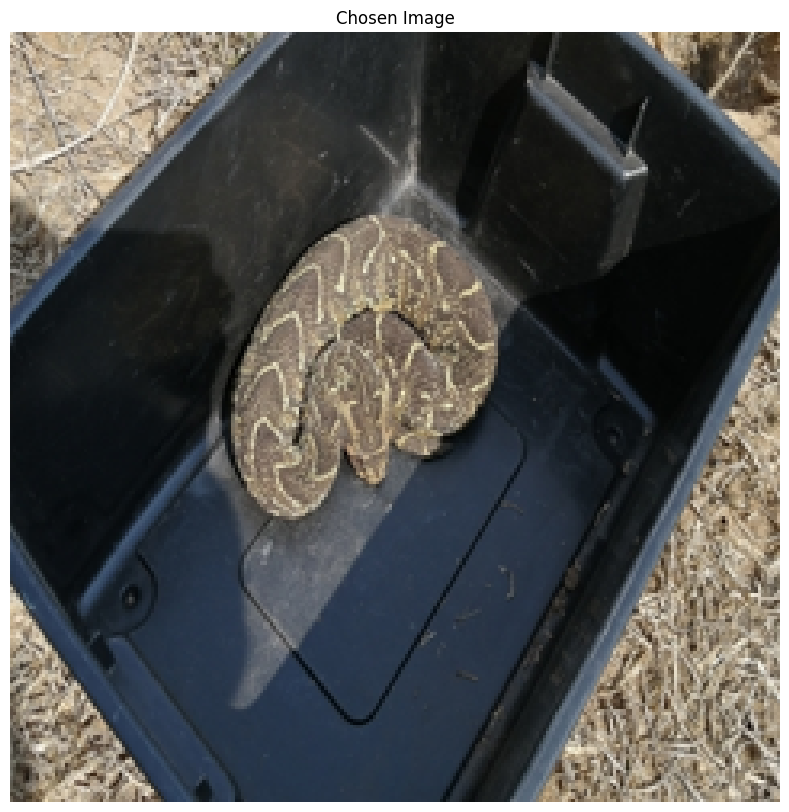

Filename: 427233f20ab14179bbf63852297a03a0.jpg
Image at index 3550 is listed in the UUIDs text file and can't be used for inference.
Filename: b8035b6ca18849f1b7bddc7b633ea80a.jpg
Image at index 14176 is listed in the UUIDs text file and can't be used for inference.
Filename: 46d1359da8a04dc181e435b2132f65b9.jpg
Image at index 16340 is listed in the UUIDs text file and can't be used for inference.
Filename: 76ac2a735a5145f4be13ab116314f83f.jpg
Image at index 6314 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 22ms/step
Predicted probabilty of the snake in picture being venomous: 0.7190714478492737
Predicted label: Venom
Actual label: Venom
True Prediction


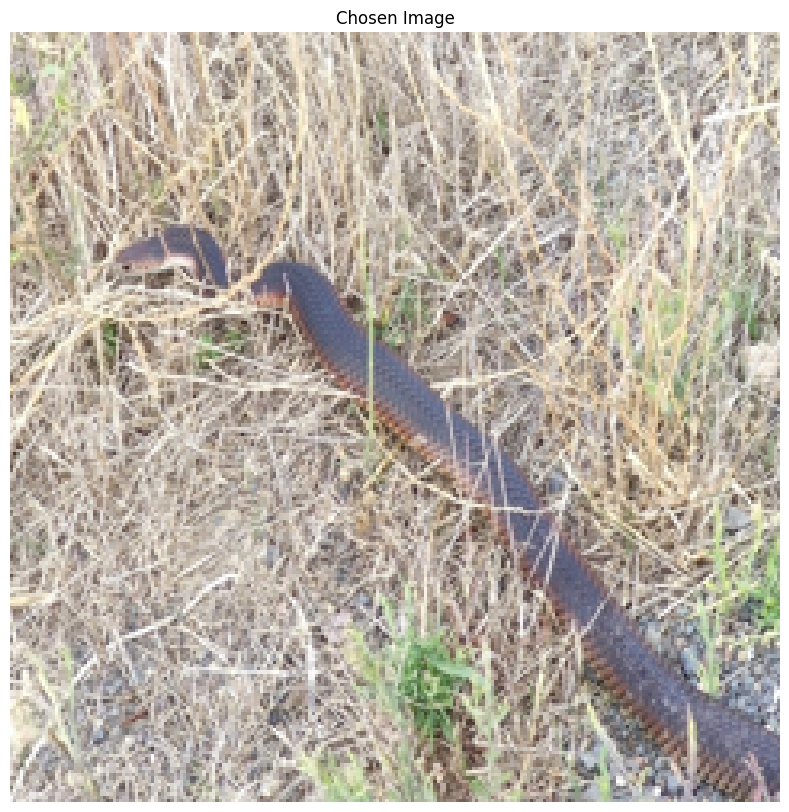

Filename: 3fba6c143fdc4140bbc93cb07bef8fff.jpg
Image at index 14056 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 19ms/step
Predicted probabilty of the snake in picture being venomous: 0.5821740627288818
Predicted label: Venom
Actual label: Venom
True Prediction


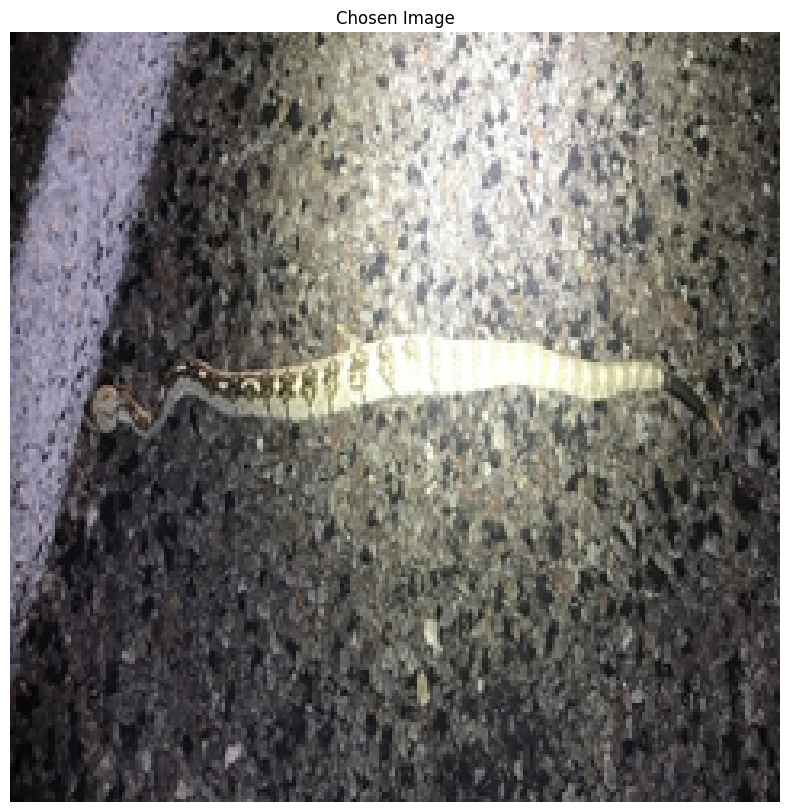

Filename: ce2f2cfec80e4a758690b3ef15d2f9d5.jpg
Image at index 3244 is listed in the UUIDs text file and can't be used for inference.
Filename: 0ca9ae231ef045e1954d437519ba2764.jpg
Image at index 6284 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 23ms/step
Predicted probabilty of the snake in picture being venomous: 0.751223623752594
Predicted label: Venom
Actual label: Venom
True Prediction


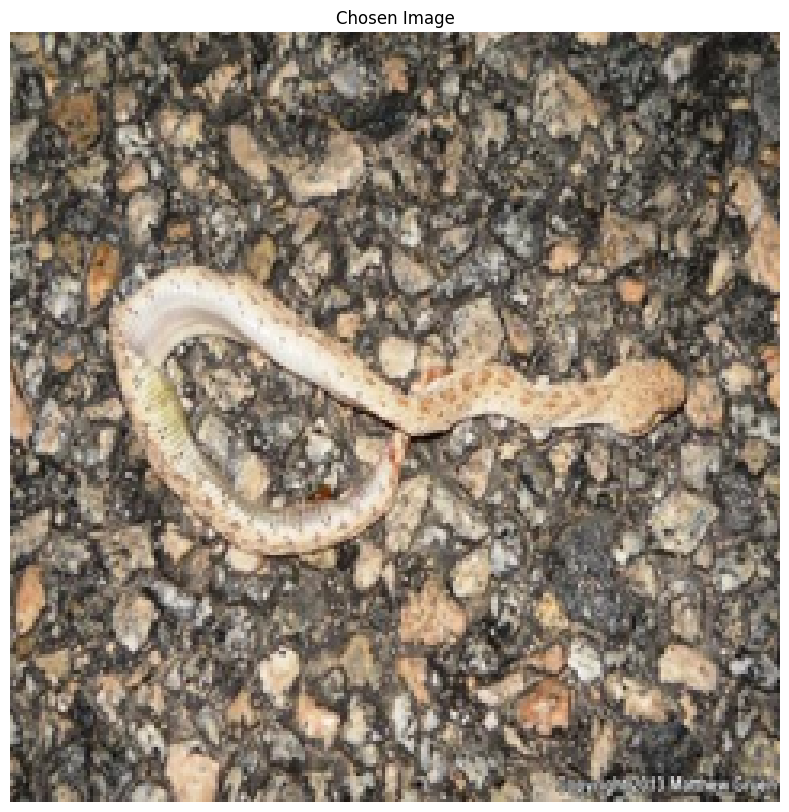

Filename: 949acbfaaa21463fa18cea96c9bf662d.jpg
Image at index 7226 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 21ms/step
Predicted probabilty of the snake in picture being venomous: 0.7413353323936462
Predicted label: Venom
Actual label: Non-Venom
False Prediction


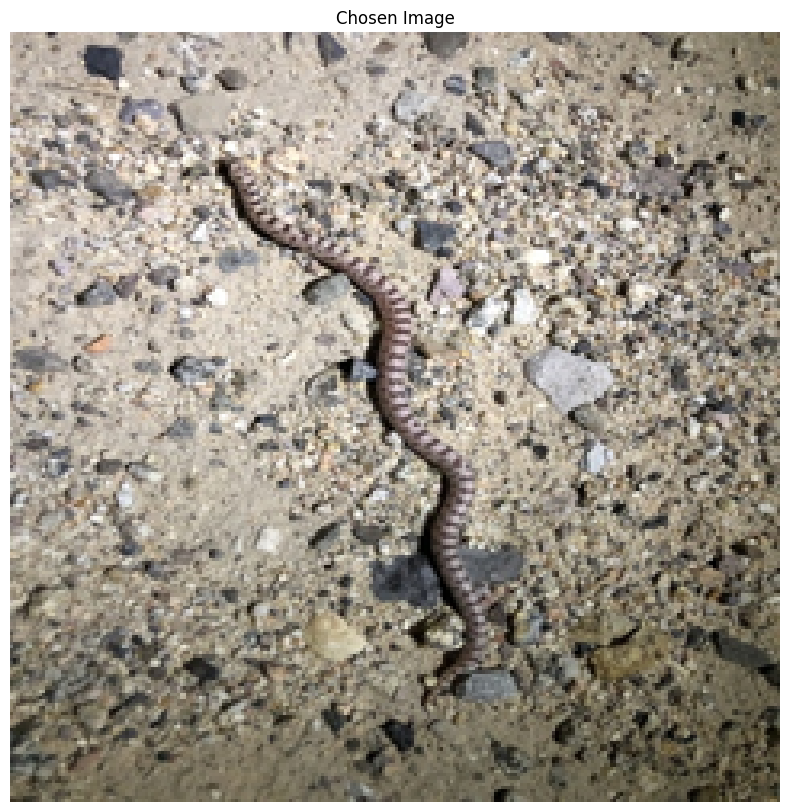

Filename: 71158301eb6b4ece9f4563414b938ca4.jpg
Image at index 8007 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 19ms/step
Predicted probabilty of the snake in picture being venomous: 0.6392433047294617
Predicted label: Venom
Actual label: Venom
True Prediction


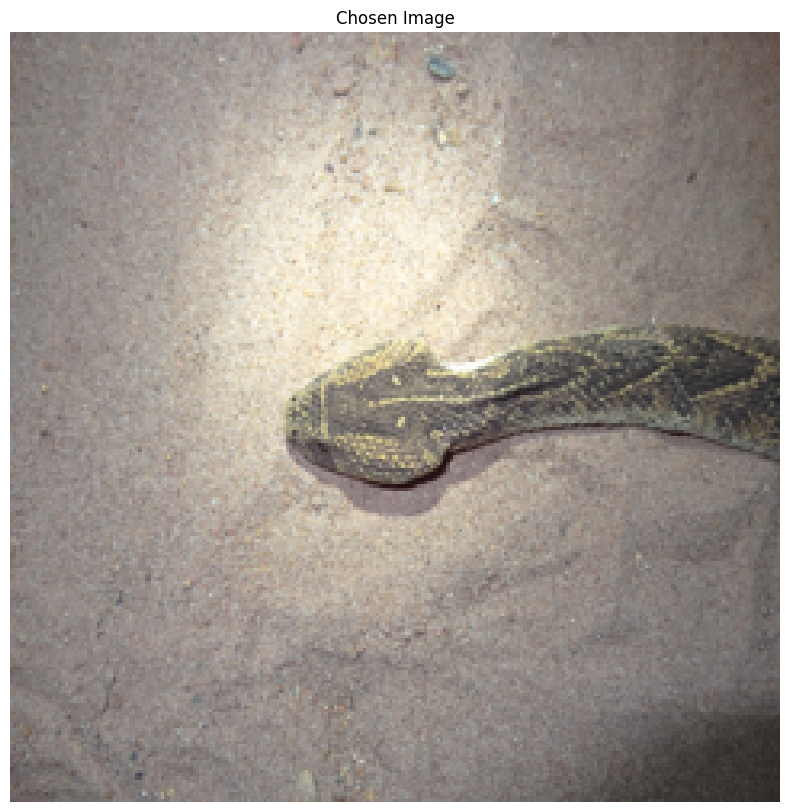

Filename: 895fcbdae6e8458ca9e153dbd08270bc.jpg
Image at index 6074 is listed in the UUIDs text file and can't be used for inference.
Filename: 8402536c8e9943aaa73d6e2ec2f51305.jpg
Image at index 5215 is listed in the UUIDs text file and can't be used for inference.
Filename: 3bb867cc74e44338b3658e6095539ffb.jpg
Image at index 18306 is listed in the UUIDs text file and can't be used for inference.
Filename: 1a2f26d09f4c4459b2dd5ca7fb19c42e.jpg
Image at index 13150 is listed in the UUIDs text file and can't be used for inference.
Filename: 76fb7444c3d3416d9471d4e21b447150.jpg
Image at index 18163 is listed in the UUIDs text file and can't be used for inference.
Filename: f6b6e8d51fb7475782379a14f03ee79d.jpg
Image at index 10584 is listed in the UUIDs text file and can't be used for inference.
Filename: 83de562115224cac9db2ffddef5deef1.jpg
Image at index 8608 is listed in the UUIDs text file and can't be used for inference.
Filename: c14cc6fc54e0487da18baaa5abfa4006.jpg
Image at index 105

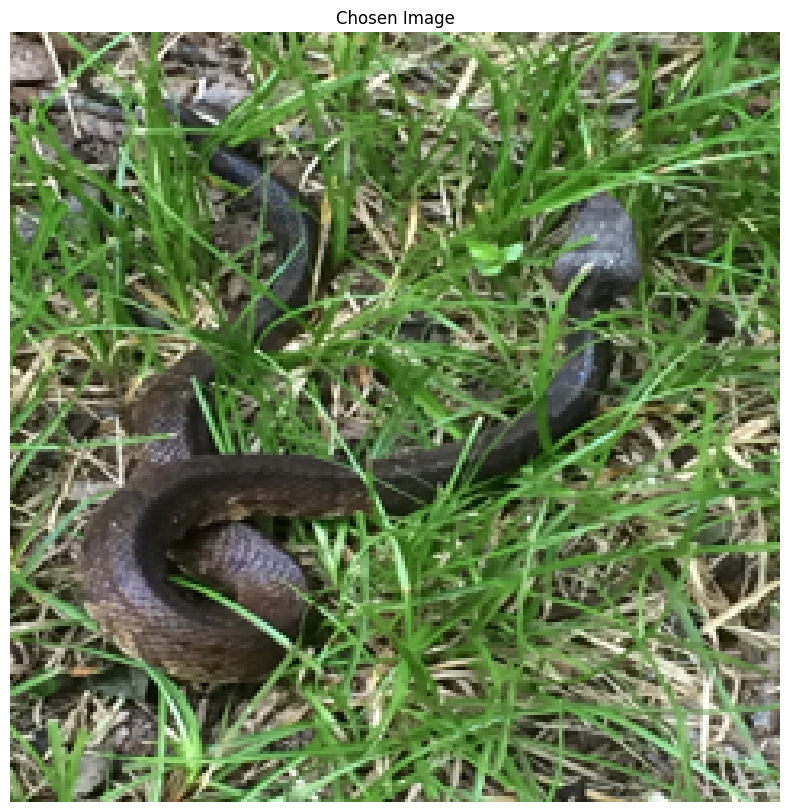

Filename: 22d245d77b47453f9639cbe199b6ff58.jpg
Image at index 10405 is not listed in the UUIDs text file. Inferencing...
1/1 [==============================] - 0s 20ms/step
Predicted probabilty of the snake in picture being venomous: 0.7192506790161133
Predicted label: Venom
Actual label: Venom
True Prediction


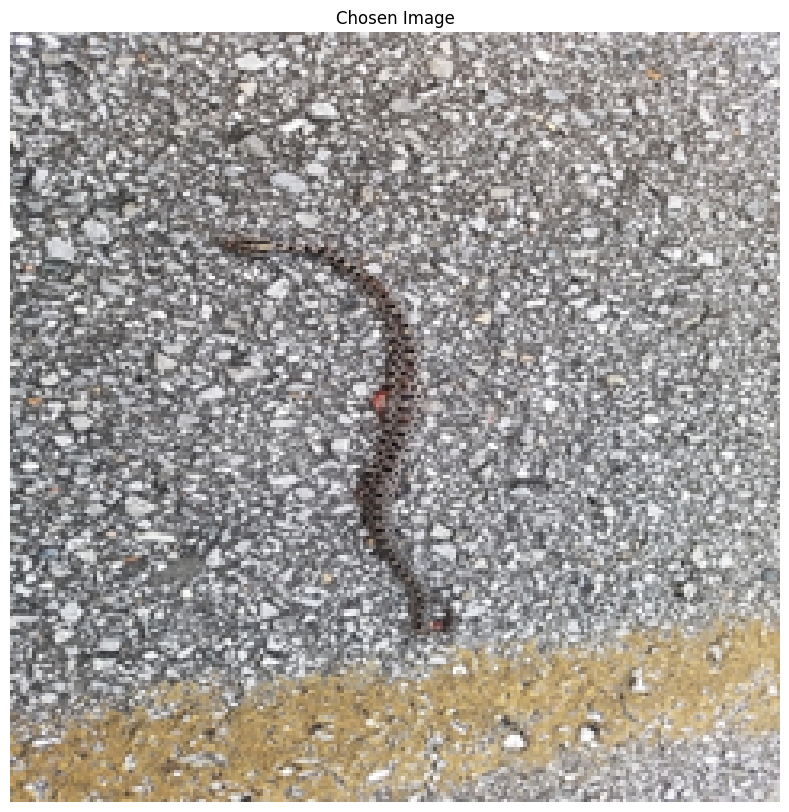

In [ ]:
# Cell 10: Inference on unseen images
uuid_file_path = "uuid_images.txt"
if os.path.exists(uuid_file_path):
    with open(uuid_file_path, 'r') as file:
        uuids = set(line.strip() for line in file)
    image_data = np.array(image_data)
    inference_count = 0
    true_negatvies = 0
    false_negatives = 0
    true_positives = 0
    false_positives = 0
    with ZipFile(zip_file_path, 'r') as zip_ref:
        while inference_count < 20:
            idx = random.randint(0, len(df) - 1)
            chosen_img_array, found = load_and_resize_image(zip_ref, df.iloc[idx]['uuid_image'])
            if found:
                gt = 'Venom' if df.iloc[idx]['poisonous'] == 1 else 'Non-Venom'
                uuid = df.iloc[idx]['uuid_image']
                print(f"Filename: {uuid}")
                if uuid in uuids:
                    print(f"Image at index {idx} is listed in the UUIDs text file and can't be used for inference.")
                    continue
                else:
                    print(f"Image at index {idx} is not listed in the UUIDs text file. Inferencing...")
                    inference_count += 1
                predicted_label = model.predict(np.expand_dims(chosen_img_array, axis=0))
                print(f"Predicted probabilty of the snake in picture being venomous: {predicted_label[0][0]}")
                prediction = "Venom" if predicted_label[0][0] >= 0.5 else "Non-Venom"
                print(f"Predicted label: {prediction}")
                print(f"Actual label: {gt}")
                if (prediction != gt):
                  print("False Prediction")
                  if prediction == "Venom" and gt == "Non-Venom":
                    false_positives += 1
                  elif prediction == "Non-Venom" and gt == "Venom":
                    false_negatives += 1
                else:
                  print("True Prediction")
                  if (prediction == "Venom" and gt == "Venom"):
                    true_positives += 1
                  elif (prediction == "Non-Venom" and gt == "Non-Venom"):
                    true_negatvies += 1
                plt.figure(figsize=(15, 10))
                plt.imshow(chosen_img_array)
                plt.axis('off')
                plt.title('Chosen Image')
                plt.show()
else:
    print("pre-existing uid list not found\n")

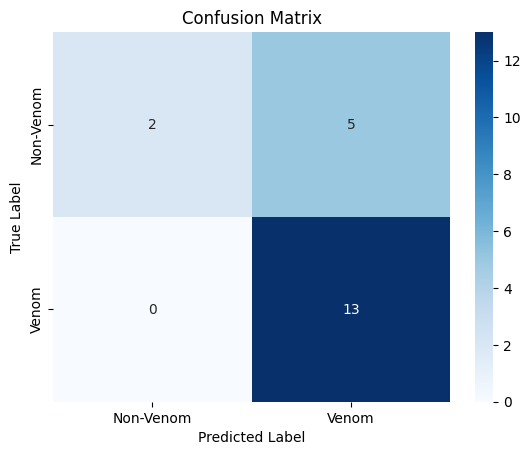

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Define the labels
labels = ['Non-Venom', 'Venom']

# Define the confusion matrix
conf_matrix = [[true_negatvies, false_positives],
               [false_negatives, true_positives]]

# Create a heatmap for visualization
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=labels, yticklabels=labels)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()
